In [14]:
import tensorflow as tf
import sys

sys.path.append('../')

from Afterthought.Objective import Objective
from Afterthought.Parameterization import Parameterization
from Afterthought.Transformation import *
from Afterthought.Regularizer import *
from Afterthought.Optimizer import *
from Afterthought.Miscellaneous import *
from Afterthought.Attribution import *
from Afterthought.Wrapper import *

print(tf.__version__)
print(tf.config.list_physical_devices('GPU'))

2.10.0
[PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')]


# Model selection

In [15]:
# Model names: https://keras.io/api/applications/

model = Wrapper(model = 'MobileNet')

print(model.layers())

['input_2', 'conv1', 'conv1_bn', 'conv1_relu', 'conv_dw_1', 'conv_dw_1_bn', 'conv_dw_1_relu', 'conv_pw_1', 'conv_pw_1_bn', 'conv_pw_1_relu', 'conv_pad_2', 'conv_dw_2', 'conv_dw_2_bn', 'conv_dw_2_relu', 'conv_pw_2', 'conv_pw_2_bn', 'conv_pw_2_relu', 'conv_dw_3', 'conv_dw_3_bn', 'conv_dw_3_relu', 'conv_pw_3', 'conv_pw_3_bn', 'conv_pw_3_relu', 'conv_pad_4', 'conv_dw_4', 'conv_dw_4_bn', 'conv_dw_4_relu', 'conv_pw_4', 'conv_pw_4_bn', 'conv_pw_4_relu', 'conv_dw_5', 'conv_dw_5_bn', 'conv_dw_5_relu', 'conv_pw_5', 'conv_pw_5_bn', 'conv_pw_5_relu', 'conv_pad_6', 'conv_dw_6', 'conv_dw_6_bn', 'conv_dw_6_relu', 'conv_pw_6', 'conv_pw_6_bn', 'conv_pw_6_relu', 'conv_dw_7', 'conv_dw_7_bn', 'conv_dw_7_relu', 'conv_pw_7', 'conv_pw_7_bn', 'conv_pw_7_relu', 'conv_dw_8', 'conv_dw_8_bn', 'conv_dw_8_relu', 'conv_pw_8', 'conv_pw_8_bn', 'conv_pw_8_relu', 'conv_dw_9', 'conv_dw_9_bn', 'conv_dw_9_relu', 'conv_pw_9', 'conv_pw_9_bn', 'conv_pw_9_relu', 'conv_dw_10', 'conv_dw_10_bn', 'conv_dw_10_relu', 'conv_pw_10', '

# Standard transformation set

In [16]:
unit = 32

# standard transformation set for optimization nice results
standard =  [padding(unit * 4),
             jitter(unit * 2, seed = 0),
             jitter(unit * 2, seed = 0),
             jitter(unit * 4, seed = 0),
             jitter(unit * 4, seed = 0),
             jitter(unit * 4, seed = 0),
             scale((0.92, 0.96), seed = 0),
             jitter(unit, seed = 0),
             jitter(unit, seed = 0),
             flip(seed = 0)]

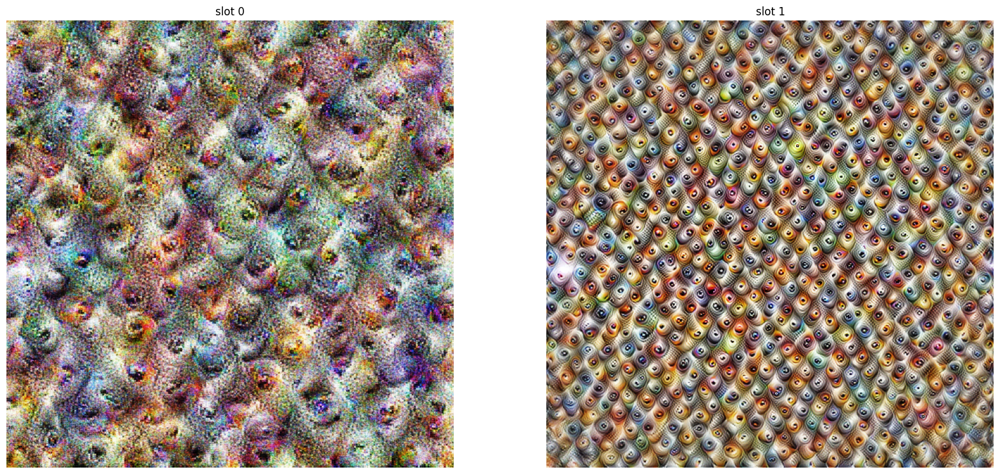

In [17]:
# Layer name
layer = 'conv_pw_6_relu'

# Check activation maximization tutorial for more details
objective = Objective.layer(model = model, 
                            layer = layer)

# Check parameterization tutorial for more details
parameterization = Parameterization.image_fft(512)

images = []

# Original output vs Transformations output
for transformation in [None] + [standard]:
    images.append(run(objective, parameterization, 
                      steps = 1000, learning_rate = 0.1,
                      transformations = [] if transformation is None else transformation,
                      verbose = False)[0])
    
plot_all(images)

# Box filter

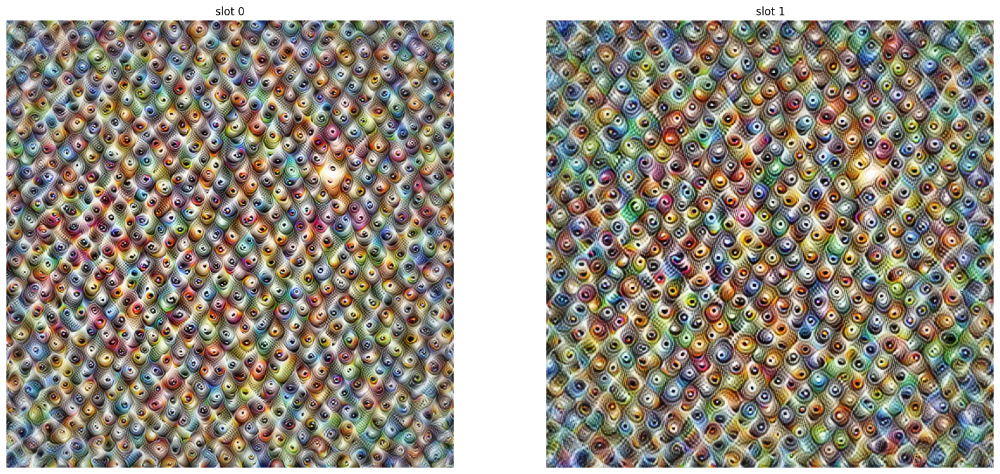

In [18]:
# Layer name
layer = 'conv_pw_6_relu'

kernel_size = 3

transformation =  [apply_kernel(kernel_size, 'BOX')]

# Check activation maximization tutorial for more details
objective = Objective.layer(model = model, 
                            layer = layer)

# Check parameterization tutorial for more details
parameterization = Parameterization.image_fft(512)

images = []

# Standard set output vs Box filter with the standard set
for transformation in [standard] + [standard + transformation]:
    images.append(run(objective, parameterization, 
                      steps = 1000, learning_rate = 0.1,
                      transformations = transformation,
                      verbose = False)[0])
    
plot_all(images)

# Sharpness filter

### Normal sharpness

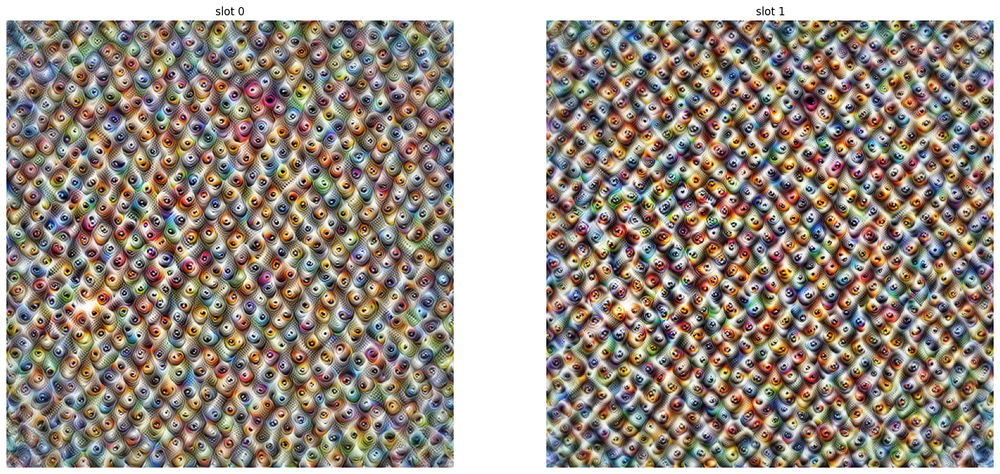

In [19]:
# Layer name
layer = 'conv_pw_6_relu'

kernel_size = 3

transformation =  [apply_kernel(kernel_size, 'SHARPNESS')]

# Check activation maximization tutorial for more details
objective = Objective.layer(model = model, 
                            layer = layer)

# Check parameterization tutorial for more details
parameterization = Parameterization.image_fft(512)

images = []

# Standard set output vs Normal sharpness with the standard set
for transformation in [standard] + [standard + transformation]:
    images.append(run(objective, parameterization, 
                      steps = 1000, learning_rate = 0.1,
                      transformations = transformation,
                      verbose = False)[0])
    
plot_all(images)

### Hard sharpness

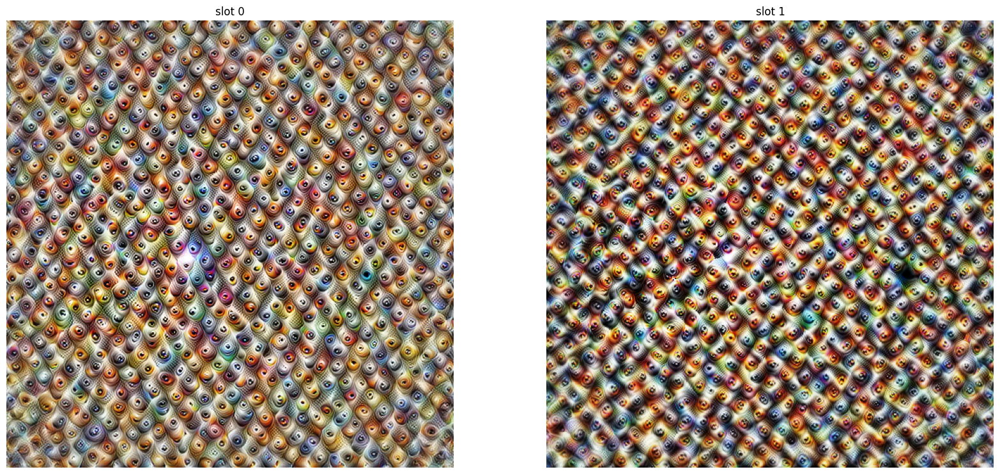

In [20]:
# Layer name
layer = 'conv_pw_6_relu'

kernel_size = 3

transformation =  [apply_kernel(kernel_size, 'HARD-SHARPNESS')]

# Check activation maximization tutorial for more details
objective = Objective.layer(model = model, 
                            layer = layer)

# Check parameterization tutorial for more details
parameterization = Parameterization.image_fft(512)

images = []

# Standard set output vs Hard sharpness with the standard set
for transformation in [standard] + [standard + transformation]:
    images.append(run(objective, parameterization, 
                      steps = 1000, learning_rate = 0.1,
                      transformations = transformation,
                      verbose = False)[0])
    
plot_all(images)

# Blur

### Gaussian Blur

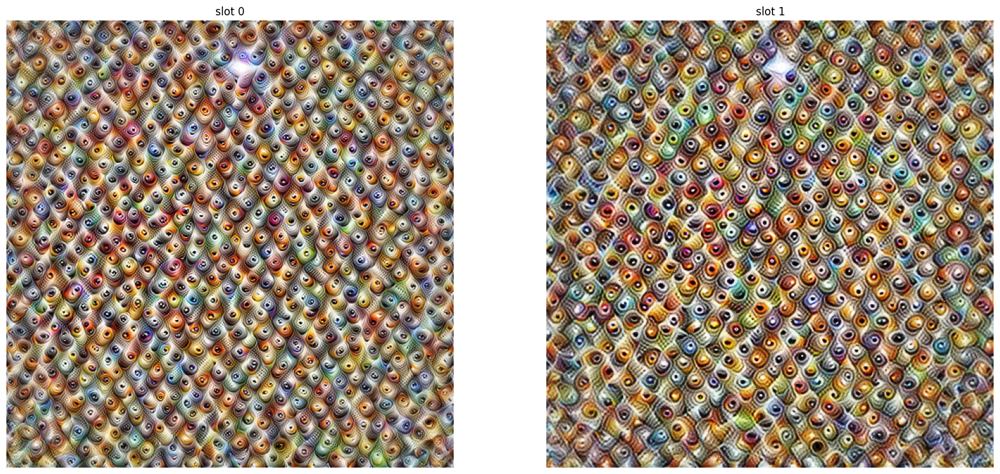

In [21]:
# Layer name
layer = 'conv_pw_6_relu'

kernel_size = 5

transformation =  [apply_kernel(kernel_size, 'GAUSSIAN-BLUR')]

# Check activation maximization tutorial for more details
objective = Objective.layer(model = model, 
                            layer = layer)

# Check parameterization tutorial for more details
parameterization = Parameterization.image_fft(512)

images = []

# Standard set output vs Gaussian blur with the standard set
for transformation in [standard] + [standard + transformation]:
    images.append(run(objective, parameterization, 
                      steps = 1000, learning_rate = 0.1,
                      transformations = transformation,
                      verbose = False)[0])
    
plot_all(images)

### Motion Blur

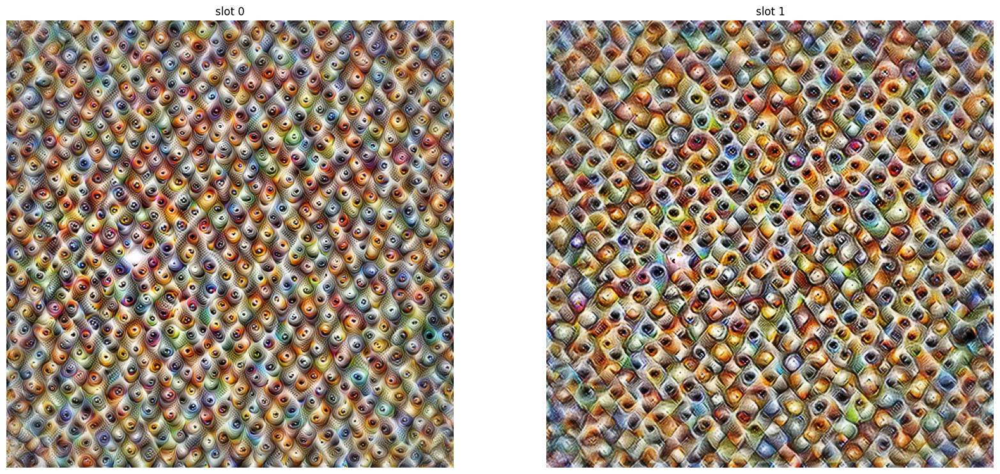

In [22]:
# Layer name
layer = 'conv_pw_6_relu'

kernel_size = 5

transformation =  [apply_kernel(kernel_size, 'MOTION-BLUR')]

# Check activation maximization tutorial for more details
objective = Objective.layer(model = model, 
                            layer = layer)

# Check parameterization tutorial for more details
parameterization = Parameterization.image_fft(512)

images = []

# Standard set output vs Motion blur with the standard set
for transformation in [standard] + [standard + transformation]:
    images.append(run(objective, parameterization, 
                      steps = 1000, learning_rate = 0.1,
                      transformations = transformation,
                      verbose = False)[0])
    
plot_all(images)

# Emboss

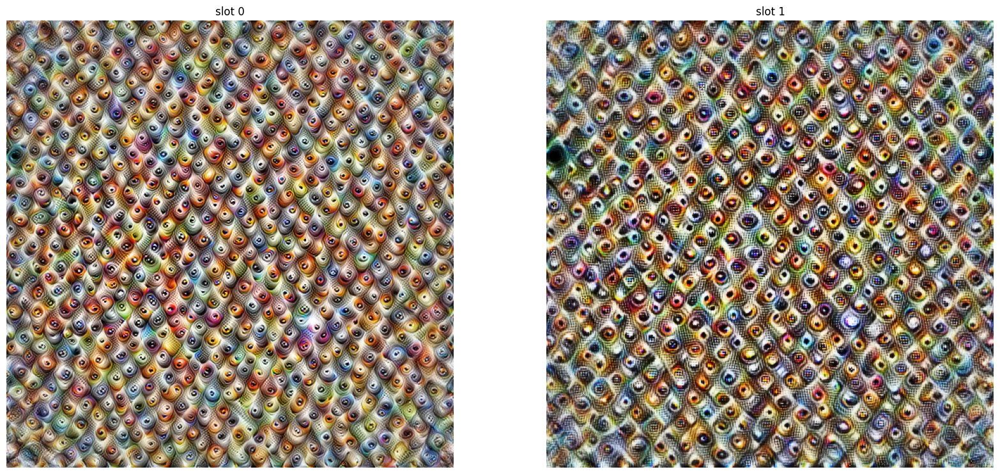

In [23]:
# Layer name
layer = 'conv_pw_6_relu'

kernel_size = 5

transformation =  [apply_double_kernel(kernel_size, 'EMBOSS')]

# Check activation maximization tutorial for more details
objective = Objective.layer(model = model, 
                            layer = layer)

# Check parameterization tutorial for more details
parameterization = Parameterization.image_fft(512)

images = []

# Standard set output vs Motion blur with the standard set
for transformation in [standard] + [standard + transformation]:
    images.append(run(objective, parameterization, 
                      steps = 1000, learning_rate = 0.1,
                      transformations = transformation,
                      verbose = False)[0])
    
plot_all(images)

# Color adjustment

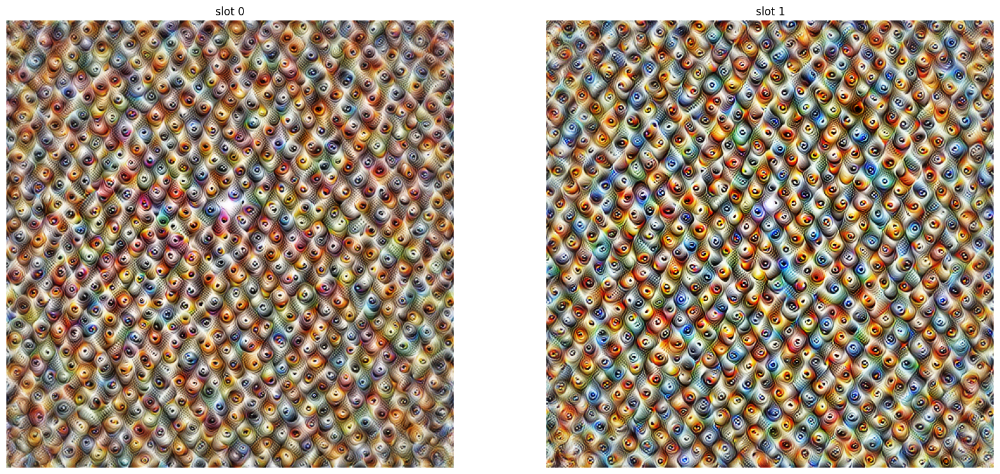

In [24]:
# Layer name
layer = 'conv_pw_6_relu'

delta = 0.5

transformation =  [adjust_hsv(delta, saturation = (0, 1))]

# Check activation maximization tutorial for more details
objective = Objective.layer(model = model, 
                            layer = layer)

# Check parameterization tutorial for more details
parameterization = Parameterization.image_fft(512)

images = []

# Standard set output vs Motion blur with the standard set
for transformation in [standard] + [standard + transformation]:
    images.append(run(objective, parameterization, 
                      steps = 1000, learning_rate = 0.1,
                      transformations = transformation,
                      verbose = False)[0])
    
plot_all(images)

# Mean and median filter

### Mean

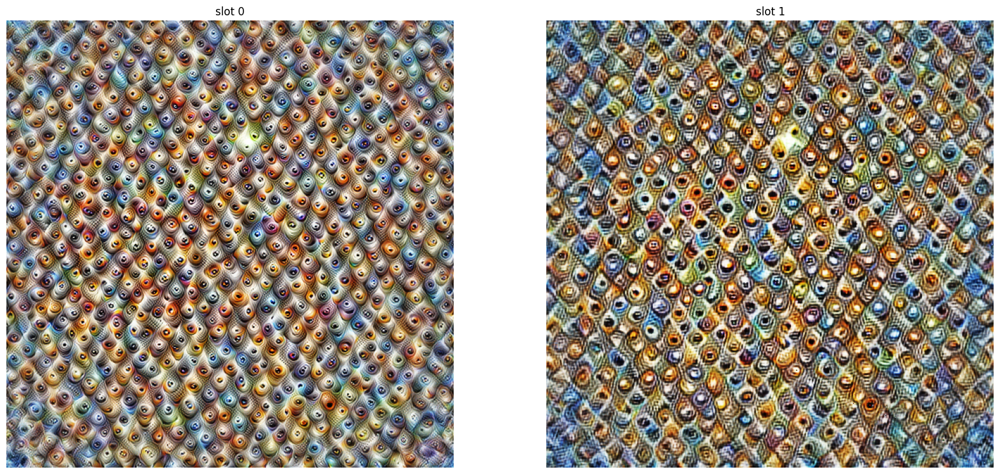

In [25]:
# Layer name
layer = 'conv_pw_6_relu'

kernel_size = 5

transformation =  [mean(kernel_size)]

# Check activation maximization tutorial for more details
objective = Objective.layer(model = model, 
                            layer = layer)

# Check parameterization tutorial for more details
parameterization = Parameterization.image_fft(512)

images = []

# Standard set output vs Mean filter with the standard set
for transformation in [standard] + [standard + transformation]:
    images.append(run(objective, parameterization, 
                      steps = 1000, learning_rate = 0.1,
                      transformations = transformation,
                      verbose = False)[0])
    
plot_all(images)

### Median

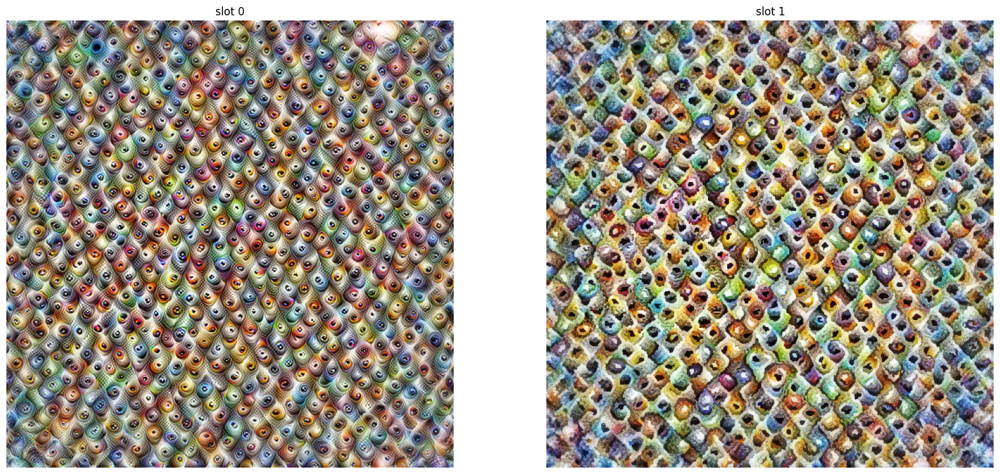

In [26]:
# Layer name
layer = 'conv_pw_6_relu'

kernel_size = 5

transformation =  [median(kernel_size)]

# Check activation maximization tutorial for more details
objective = Objective.layer(model = model, 
                            layer = layer)

# Check parameterization tutorial for more details
parameterization = Parameterization.image_fft(512)

images = []

# Standard set output vs Median filter with the standard set
for transformation in [standard] + [standard + transformation]:
    images.append(run(objective, parameterization, 
                      steps = 1000, learning_rate = 0.1,
                      transformations = transformation,
                      verbose = False)[0])
    
plot_all(images)